# My Session 3

In [1]:
# First check the Python version
import sys
if sys.version_info < (3,4):
    print('You are running an older version of Python!\n\n' \
          'You should consider updating to Python 3.4.0 or ' \
          'higher as the libraries built for this course ' \
          'have only been tested in Python 3.4 and higher.\n')
    print('Try installing the Python 3.5 version of anaconda '
          'and then restart `jupyter notebook`:\n' \
          'https://www.continuum.io/downloads\n\n')

# Now get necessary libraries
try:
    import os
    import numpy as np
    import matplotlib.pyplot as plt
    from skimage.transform import resize
    from skimage import data
    from scipy.misc import imresize
    import IPython.display as ipyd
except ImportError:
    print('You are missing some packages! ' \
          'We will try installing them before continuing!')
    !pip install "numpy>=1.11.0" "matplotlib>=1.5.1" "scikit-image>=0.11.3" "scikit-learn>=0.17" "scipy>=0.17.0"
    import os
    import numpy as np
    import matplotlib.pyplot as plt
    from skimage.transform import resize
    from skimage import data
    from scipy.misc import imresize
    import IPython.display as ipyd
    print('Done!')

# Import Tensorflow
try:
    import tensorflow as tf
except ImportError:
    print("You do not have tensorflow installed!")
    print("Follow the instructions on the following link")
    print("to install tensorflow before continuing:")
    print("")
    print("https://github.com/pkmital/CADL#installation-preliminaries")

# This cell includes the provided libraries from the zip file
# and a library for displaying images from ipython, which
# we will use to display the gif
try:
    from libs import utils, gif, datasets, dataset_utils, vae, dft, tboard
except ImportError:
    print("Make sure you have started notebook in the same directory" +
          " as the provided zip file which includes the 'libs' folder" +
          " and the file 'utils.py' inside of it.  You will NOT be able"
          " to complete this assignment unless you restart jupyter"
          " notebook inside the directory created by extracting"
          " the zip file or cloning the github repo.")

# We'll tell matplotlib to inline any drawn figures like so:
%matplotlib inline
plt.style.use('ggplot')

# Part One - Autoencoders

In [2]:
def crop_edge(img, cropped_rate):
    """Crop arbitrary amount of pixel.
    """
    row_i = int(img.shape[0] * cropped_rate) // 2
    col_i = int(img.shape[1] * cropped_rate) // 2
    return img[row_i:-row_i, col_i:-col_i]

In [3]:
# See how this works w/ Celeb Images or try your own dataset instead:
dirname = '../data/pokemon/jpeg/'

# Load every image file in the provided directory
filenames = [os.path.join(dirname, fname)
             for fname in os.listdir(dirname)]
# imgs = [plt.imread(fname)[..., :3] for fname in filenames]

imgs = [imresize(crop_edge(plt.imread(f), 0.4), (64, 64)) for f in filenames]
imgs = np.array(imgs)

# Shuffle and limit the number of files to process
nb_clip = 100
np.random.shuffle(imgs)
imgs = imgs[:nb_clip]

# Then convert the list of images to a 4d array (e.g. use np.array to convert a list to a 4d array):
Xs = imgs.reshape(-1, 64, 64, 3 )

print(Xs.shape)
assert(Xs.ndim == 4 and Xs.shape[1] <= 100 and Xs.shape[2] <= 100)

(100, 64, 64, 3)


In [4]:
ds = datasets.Dataset(Xs)

## Normalization

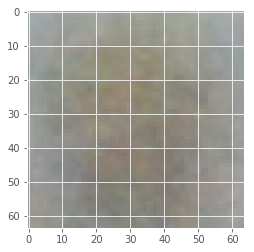

In [5]:
mean_img = ds.mean().astype(np.uint8)
plt.imshow(mean_img)
# If your image comes out entirely black, try w/o the `astype(np.uint8)`
# that means your images are read in as 0-255, rather than 0-1 and 
# this simply depends on the version of matplotlib you are using.

(64, 64, 3)


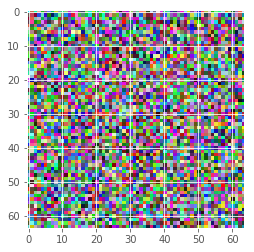

In [6]:
std_img = ds.std()
plt.imshow(std_img)
print(std_img.shape)

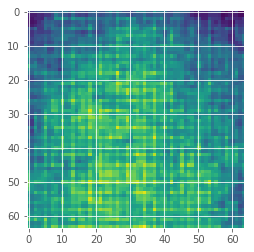

In [7]:
std_img = np.mean(std_img, axis=2)
plt.imshow(std_img)

(100, 64, 64, 3)


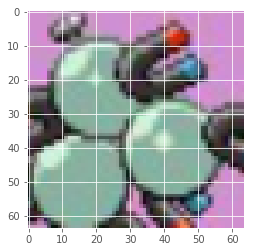

In [8]:
plt.imshow(ds.X[0])
print(ds.X.shape)

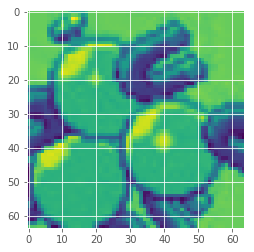

In [9]:
plt.imshow(ds.X[0].mean(axis=2))

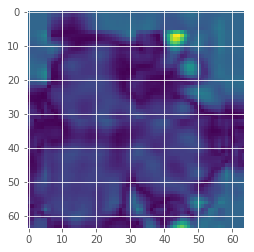

In [10]:
plt.imshow(ds.X[0].std(axis=2))

## Preprocess and deprocess

In [11]:
# Write a function to preprocess/normalize an image, given its dataset object
# (which stores the mean and standard deviation!)
def preprocess(img, ds):
    norm_img = (img - ds.mean()) / ds.std()
    return norm_img

# Write a function to undo the normalization of an image, given its dataset object
# (which stores the mean and standard deviation!)
def deprocess(norm_img, ds):
    img = norm_img * ds.std() + ds.mean()
    return img

In [12]:
nb_features = len(ds.X[0].flatten())
print(nb_features)

12288


In [13]:
64*64*3

12288

In [14]:
encoder_dimensions = [1024, 64, 4]

## Graph time

In [15]:
tf.reset_default_graph()

In [16]:
X = tf.placeholder(np.float32, [None, nb_features])
                   
assert(X.get_shape().as_list() == [None, nb_features])

## Encoder

In [17]:
def encode(X, dimensions, activation=tf.nn.tanh):
    # We're going to keep every matrix we create so let's create a list to hold them all
    Ws = []
    # We'll create a for loop to create each layer:
    for layer_i, nb_output in enumerate(dimensions):

        # TODO: just like in the last session,
        # we'll use a variable scope to help encapsulate our variables
        # This will simply prefix all the variables made in this scope
        # with the name we give it.  Make sure it is a unique name
        # for each layer, e.g., 'encoder/layer1', 'encoder/layer2', or
        # 'encoder/1', 'encoder/2',... 
        with tf.variable_scope('encode/layer{}'.format(layer_i)):

            # TODO: Create a weight matrix which will increasingly reduce
            # down the amount of information in the input by performing
            # a matrix multiplication.  You can use the utils.linear function.
            h, W = utils.linear(X, nb_output, activation=activation)
            
            # TODO: Apply an activation function (unless you used the parameter
            # for activation function in the utils.linear call)

            # Finally we'll store the weight matrix.
            # We need to keep track of all
            # the weight matrices we've used in our encoder
            # so that we can build the decoder using the
            # same weight matrices.
            Ws.append(W)
            
            # Replace X with the current layer's output, so we can
            # use it in the next layer.
            X = h
            print("layer/{}/X".format(layer_i))
            print(X.get_shape())

    z = X
    print("enode/global/X/")
    print(X.get_shape())
    return Ws, z

In [18]:
# Then call the function
Ws, Z = encode(X, encoder_dimensions)

# And just some checks to make sure you've done it right.
# assert(Z.get_shape().as_list() == [None, 2])
# assert(len(Ws) == len(encoder_dimensions))

layer/0/X
(?, 1024)
layer/1/X
(?, 64)
layer/2/X
(?, 4)
enode/global/X/
(?, 4)


In [19]:
[W_i.get_shape().as_list() for W_i in Ws]

[[12288, 1024], [1024, 64], [64, 4]]

In [20]:
Z.get_shape().as_list()

[None, 4]

## Decoder

In [21]:
# We'll first reverse the order of our weight matrices
decoder_Ws = Ws[::-1]

# then reverse the order of our dimensions
# appending the last layers number of inputs.
decoder_dimensions = encoder_dimensions[::-1][1:] + [nb_features]
print(decoder_dimensions)

assert(decoder_dimensions[-1] == nb_features)

[64, 1024, 12288]


In [22]:
def decode(z, dimensions, Ws, activation=tf.nn.tanh):
    current_input = z
    for layer_i, n_output in enumerate(dimensions):
        # we'll use a variable scope again to help encapsulate our variables
        # This will simply prefix all the variables made in this scope
        # with the name we give it.
        with tf.variable_scope("decoder/layer/{}".format(layer_i)):

            # Now we'll grab the weight matrix we created before and transpose it
            # So a 3072 x 784 matrix would become 784 x 3072
            # or a 256 x 64 matrix, would become 64 x 256
            W = tf.transpose(Ws[layer_i])

            # Now we'll multiply our input by our transposed W matrix
            h = tf.matmul(current_input, W)

            # And then use a relu activation function on its output
            current_input = activation(h)

            # We'll also replace n_input with the current n_output, so that on the
            # next iteration, our new number inputs will be correct.
            n_input = n_output
    Y = current_input
    return Y

In [23]:
Y = decode(Z, decoder_dimensions, decoder_Ws)

In [24]:
Y.get_shape().as_list()

[None, 12288]

## Optimizer

In [25]:
# Calculate some measure of loss, e.g. the pixel to pixel absolute difference or squared difference
# loss = tf.reduce_mean(tf.squared_difference(X, Y), 1)
loss = tf.squared_difference(X, Y)
# Now sum over every pixel and then calculate the mean over the batch dimension (just like session 2!)
# hint, use tf.reduce_mean and tf.reduce_sum
cost = tf.reduce_sum(loss)

In [26]:
learning_rate = 0.001
optimizer = tf.train.AdamOptimizer(learning_rate==learning_rate).minimize(cost)

In [27]:
# (TODO) Create a tensorflow session and initialize all of our weights:
sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())

## All aboard the Tensorboard

In [28]:
from libs import tboard
tboard.show_graph(tf.get_default_graph().as_graph_def())

## Training

0 166.6151875


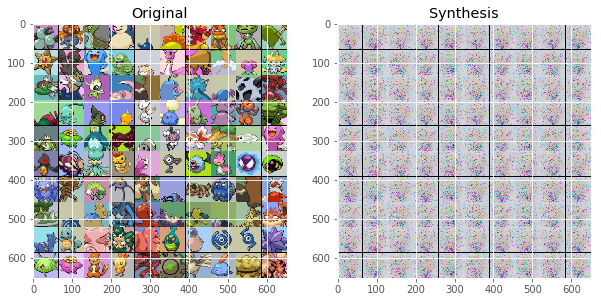

1 166.6151375
2 166.6151875
3 166.615125
4 166.6151375
5 166.6152125
6 166.6151625
7 166.6151375
8 166.6151125
9 166.6151625
10 166.61515


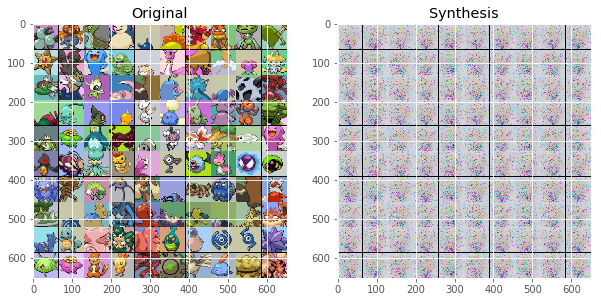

11 166.6152125
12 166.615025
13 166.615075
14 166.615225
15 166.61515
16 166.615125
17 166.615175
18 166.61515
19 166.6151625
20 166.6151375


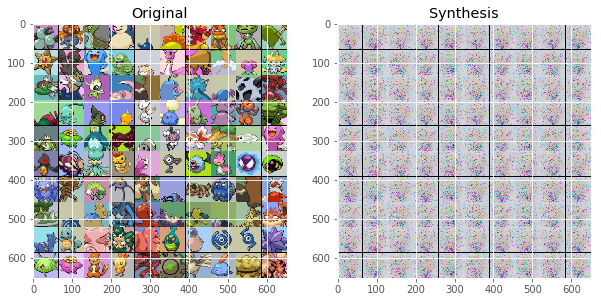

21 166.6152
22 166.615125
23 166.6151
24 166.6151375
25 166.6151375
26 166.61525
27 166.6151875
28 166.6151125
29 166.615175
30 166.6151375


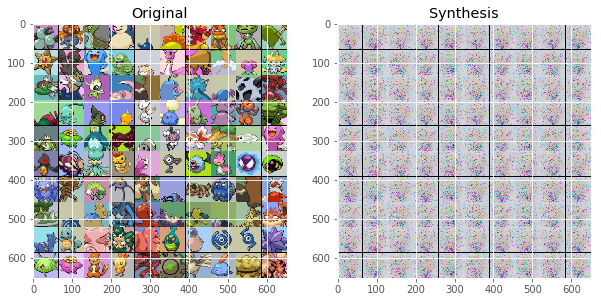

31 166.6151875
32 166.61515
33 166.6151125
34 166.6151875
35 166.6151625
36 166.6151875
37 166.6151875
38 166.6150875
39 166.61515
40 166.615175


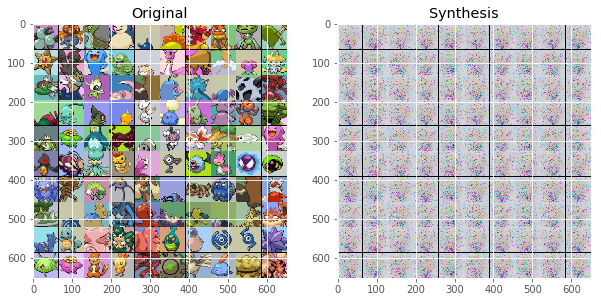

41 166.6151625
42 166.6151
43 166.615175
44 166.6152125
45 166.6152125
46 166.6151625
47 166.615125
48 166.6151375
49 166.6152875
50 166.6151625


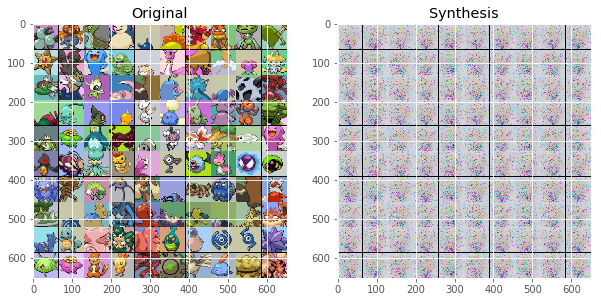

51 166.61515
52 166.6151875
53 166.6151
54 166.6151375
55 166.6151
56 166.615175
57 166.6151875
58 166.6151
59 166.6152
60 166.615125


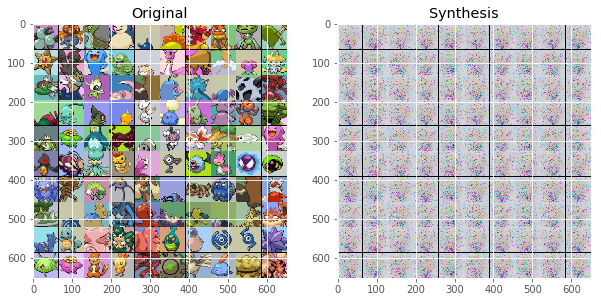

61 166.615175
62 166.6151625
63 166.6151875
64 166.615175
65 166.6152625
66 166.6151375
67 166.615175
68 166.6151375
69 166.6151
70 166.6152


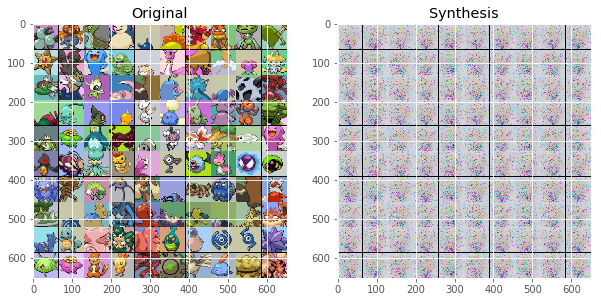

71 166.6151125
72 166.615225
73 166.61515
74 166.615175
75 166.615125
76 166.6151625
77 166.6150875
78 166.6151875
79 166.6152
80 166.615225


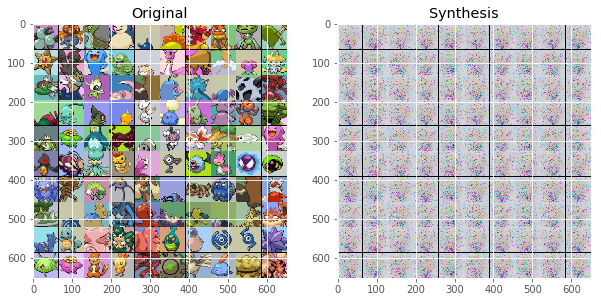

81 166.615175
82 166.61515
83 166.61515
84 166.6151375
85 166.6151625
86 166.6151
87 166.6151125
88 166.6151625
89 166.6151125
90 166.61515


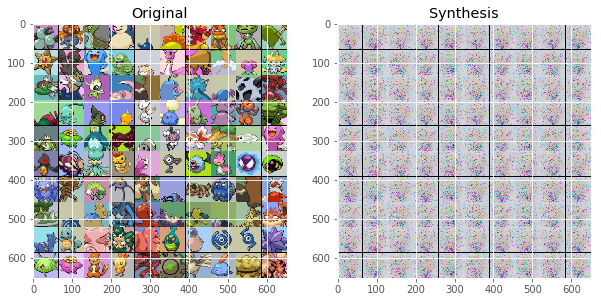

91 166.615125
92 166.6151375
93 166.61515
94 166.6151625
95 166.6151625
96 166.6151125
97 166.6152
98 166.615125
99 166.6151625
100 166.6151


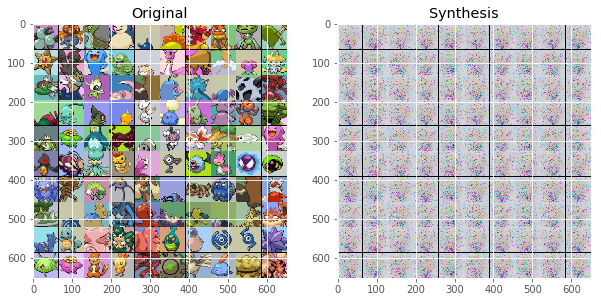

101 166.615175
102 166.615125
103 166.6151875
104 166.6152
105 166.6152
106 166.6150625
107 166.6150875
108 166.61515
109 166.6152
110 166.61515


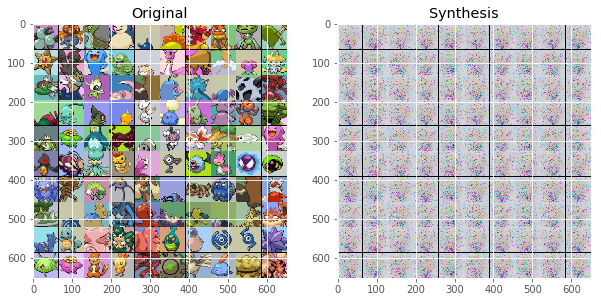

111 166.615175
112 166.6151375
113 166.61515
114 166.615075
115 166.6151375
116 166.6151375
117 166.6151625
118 166.6150625
119 166.615125
120 166.615125


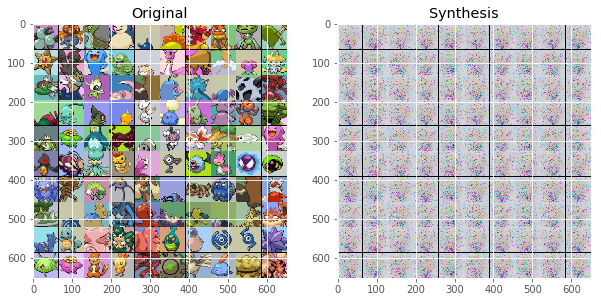

121 166.61515
122 166.615125
123 166.615225
124 166.6151125
125 166.6152
126 166.615175
127 166.615075
128 166.615125
129 166.6151125
130 166.6152


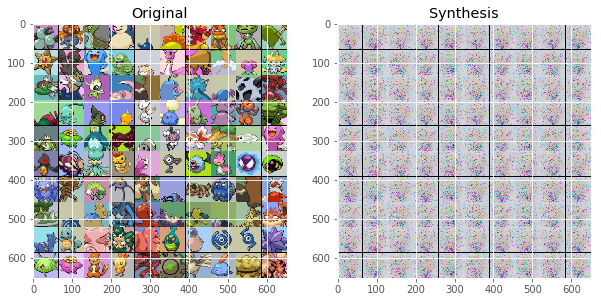

131 166.6151625
132 166.6151375
133 166.6151875
134 166.615075
135 166.61515
136 166.6150875
137 166.6150875
138 166.615175
139 166.6151
140 166.6151625


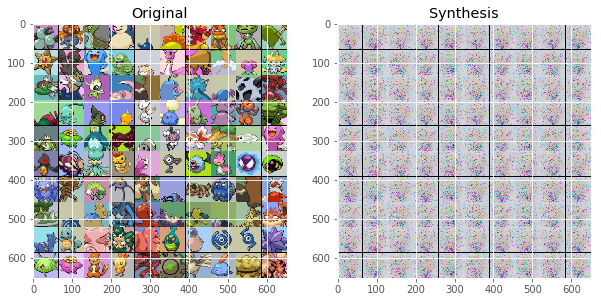

141 166.615075
142 166.6151125
143 166.61525
144 166.61515
145 166.6152
146 166.61515
147 166.6152
148 166.6151125
149 166.6152
150 166.615175


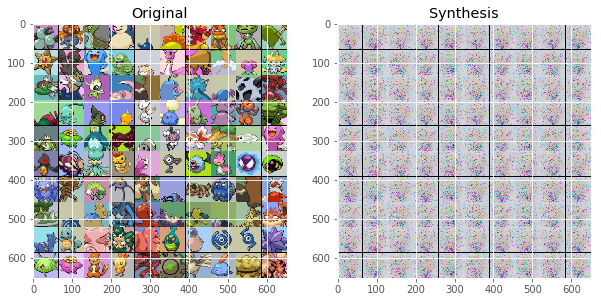

151 166.6151375
152 166.6151125
153 166.6151625
154 166.6151
155 166.615075
156 166.6151625
157 166.615125
158 166.6152125
159 166.615125
160 166.615175


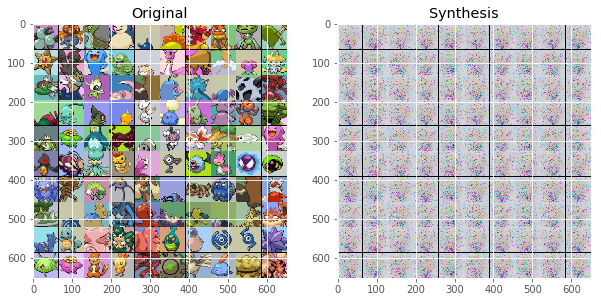

161 166.615175
162 166.6151125
163 166.6151875
164 166.615225
165 166.615125
166 166.6152
167 166.6152125
168 166.615175
169 166.6152
170 166.615175


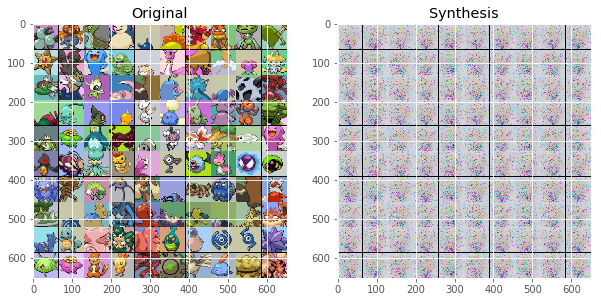

171 166.6151375
172 166.6152375
173 166.6151375
174 166.6151
175 166.61515
176 166.6151
177 166.6151
178 166.615225
179 166.6151625
180 166.615175


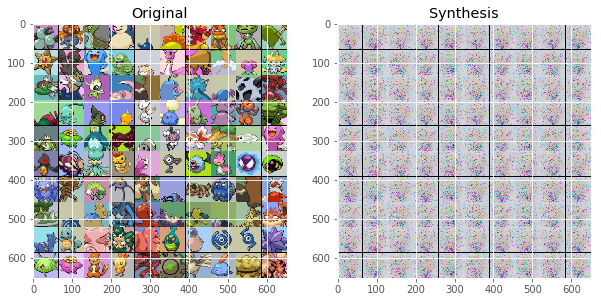

181 166.615225
182 166.6152125
183 166.615175
184 166.6151
185 166.6151625
186 166.615175
187 166.6151375
188 166.6151625
189 166.6151375
190 166.6151625


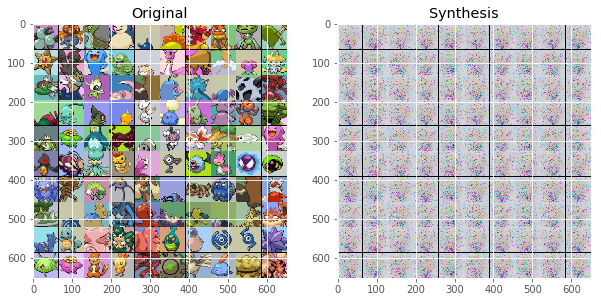

191 166.6150875
192 166.6152125
193 166.6151875
194 166.61515
195 166.6151375
196 166.6150875
197 166.615175
198 166.615175
199 166.6151875
200 166.6151125


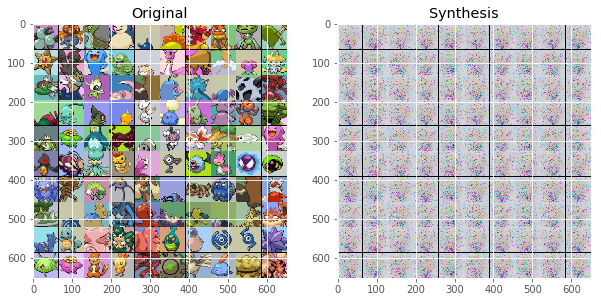

201 166.6150875
202 166.6151625
203 166.6152
204 166.6151375
205 166.6151
206 166.6152375
207 166.615125
208 166.6151625
209 166.6151625
210 166.6150875


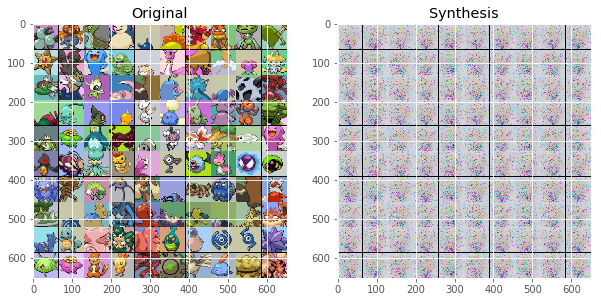

211 166.6151375
212 166.6150875
213 166.615125
214 166.6151125
215 166.6151875
216 166.615225
217 166.6151875
218 166.6151875
219 166.615175
220 166.615175


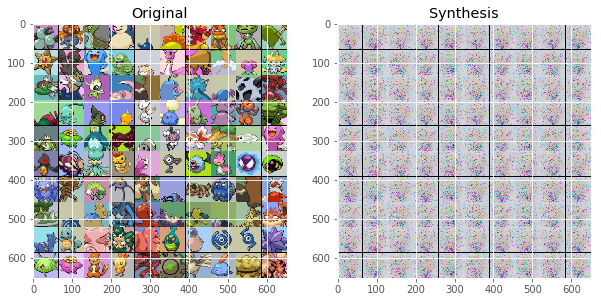

221 166.615225
222 166.615075
223 166.615125
224 166.61515
225 166.6151
226 166.6152
227 166.6152
228 166.6151875
229 166.61515
230 166.615175


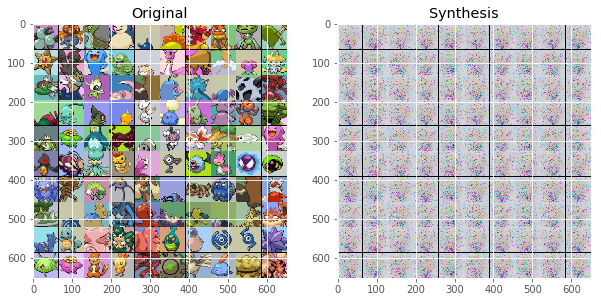

231 166.6151875
232 166.6152375
233 166.6151375
234 166.615175
235 166.6152125
236 166.615175
237 166.6152
238 166.615275
239 166.6152
240 166.61525


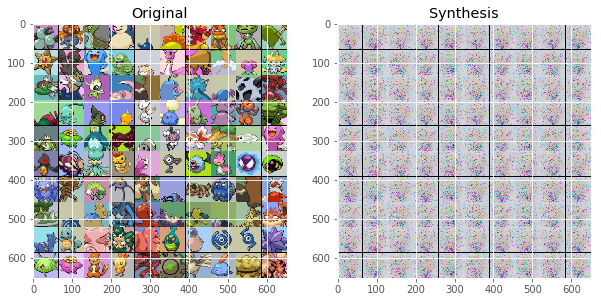

241 166.6151375
242 166.61515
243 166.615175
244 166.6151125
245 166.61515
246 166.615125
247 166.6151875
248 166.6151
249 166.6151875
250 166.6151875


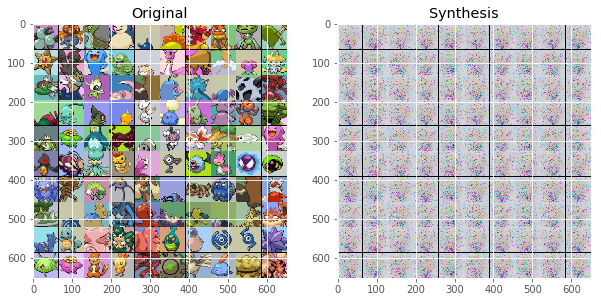

251 166.6151375
252 166.6151875


KeyboardInterrupt: 

In [30]:
# Some parameters for training
batch_size = 100
nb_epochs = 401
step = 10

# We'll try to reconstruct the same first 100 images and show how
# The network does over the course of training.
examples = ds.X[:100]

# We have to preprocess the images before feeding them to the network.
# I'll do this once here, so we don't have to do it every iteration.
test_examples = preprocess(examples, ds).reshape(-1, nb_features)

# If we want to just visualize them, we can create a montage.
test_images = utils.montage(examples).astype(np.uint8)

# Store images so we can make a gif
gifs = []

# Now for our training:
for epoch_i in range(nb_epochs):
    
    # Keep track of the cost
    this_cost = 0
    
    # Iterate over the entire dataset in batches
    for batch_X, _ in ds.train.next_batch(batch_size=batch_size):
        
        # (TODO) Preprocess and reshape our current batch, batch_X:
        this_batch = preprocess(batch_X, ds).reshape(-1, nb_features)
        
        # Compute the cost, and run the optimizer.
        this_cost += sess.run([cost, optimizer], feed_dict={X: this_batch})[0]
    
    # Average cost of this epoch
    avg_cost = this_cost / ds.X.shape[0] / batch_size
    print(epoch_i, avg_cost)
    
    # Let's also try to see how the network currently reconstructs the input.
    # We'll draw the reconstruction every `step` iterations.
    if epoch_i % step == 0:
        
        # (TODO) Ask for the output of the network, Y, and give it our test examples
        recon = sess.run(Y, feed_dict={X: batch_X.reshape(-1, nb_features)})
                         
        # Resize the 2d to the 4d representation:
        rsz = recon.reshape(examples.shape)

        # We have to unprocess the image now, removing the normalization
        unnorm_img = deprocess(rsz, ds)
                         
        # Clip to avoid saturation
        # TODO: Make sure this image is the correct range, e.g.
        # for float32 0-1, you should clip between 0 and 1
        # for uint8 0-255, you should clip between 0 and 255!
        clipped = np.clip(unnorm_img, 0, 255)

        # And we can create a montage of the reconstruction
        recon = utils.montage(clipped).astype(np.uint8)
        
        # Store for gif
        gifs.append(recon)

        fig, axs = plt.subplots(1, 2, figsize=(10, 10))
        axs[0].imshow(test_images)
        axs[0].set_title('Original')
        axs[1].imshow(recon)
        axs[1].set_title('Synthesis')
        fig.canvas.draw()
        plt.show()

# Alternate

In [31]:
# First check the Python version
import sys
if sys.version_info < (3,4):
    print('You are running an older version of Python!\n\n' \
          'You should consider updating to Python 3.4.0 or ' \
          'higher as the libraries built for this course ' \
          'have only been tested in Python 3.4 and higher.\n')
    print('Try installing the Python 3.5 version of anaconda '
          'and then restart `jupyter notebook`:\n' \
          'https://www.continuum.io/downloads\n\n')

# Now get necessary libraries
try:
    import os
    import numpy as np
    import matplotlib.pyplot as plt
    from skimage.transform import resize
    from skimage import data
    from scipy.misc import imresize
    import IPython.display as ipyd
except ImportError:
    print('You are missing some packages! ' \
          'We will try installing them before continuing!')
    !pip install "numpy>=1.11.0" "matplotlib>=1.5.1" "scikit-image>=0.11.3" "scikit-learn>=0.17" "scipy>=0.17.0"
    import os
    import numpy as np
    import matplotlib.pyplot as plt
    from skimage.transform import resize
    from skimage import data
    from scipy.misc import imresize
    import IPython.display as ipyd
    print('Done!')

# Import Tensorflow
try:
    import tensorflow as tf
except ImportError:
    print("You do not have tensorflow installed!")
    print("Follow the instructions on the following link")
    print("to install tensorflow before continuing:")
    print("")
    print("https://github.com/pkmital/CADL#installation-preliminaries")

# This cell includes the provided libraries from the zip file
# and a library for displaying images from ipython, which
# we will use to display the gif
try:
    from libs import utils, gif, datasets, dataset_utils, vae, dft
except ImportError:
    print("Make sure you have started notebook in the same directory" +
          " as the provided zip file which includes the 'libs' folder" +
          " and the file 'utils.py' inside of it.  You will NOT be able"
          " to complete this assignment unless you restart jupyter"
          " notebook inside the directory created by extracting"
          " the zip file or cloning the github repo.")

# We'll tell matplotlib to inline any drawn figures like so:
%matplotlib inline
plt.style.use('ggplot')

## Load

In [32]:
def crop_edge(img, cropped_rate):
    """Crop arbitrary amount of pixel.
    """
    row_i = int(img.shape[0] * cropped_rate) // 2
    col_i = int(img.shape[1] * cropped_rate) // 2
    return img[row_i:-row_i, col_i:-col_i]

(100, 100, 100, 3)


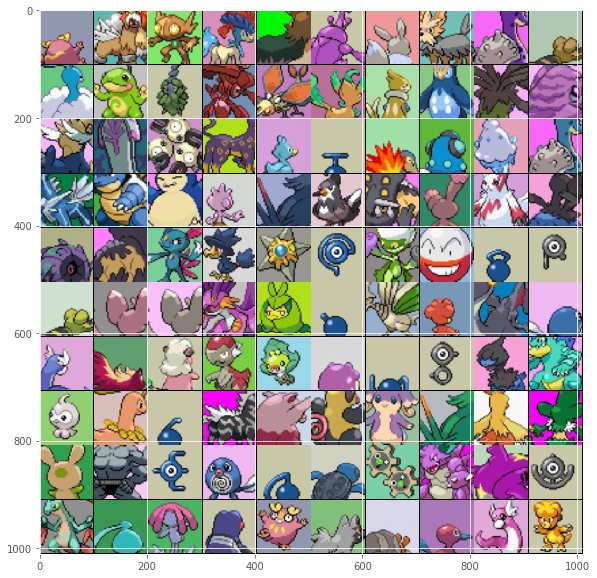

In [33]:
# See how this works w/ Celeb Images or try your own dataset instead:
filenames = [os.path.join('../data/pokemon/jpeg/', file_i)
              for file_i in os.listdir('../data/pokemon/jpeg/')
              if '.jpg' in file_i]

nb_clip = 100
filenames = filenames[:nb_clip]
imgs = [imresize(crop_edge(plt.imread(f), 0.4), (100, 100)) for f in filenames]

# Then convert the list of images to a 4d array (e.g. use np.array to convert a list to a 4d array):
Xs = np.array(imgs)

print(Xs.shape)
assert(Xs.ndim == 4 and Xs.shape[1] <= 250 and Xs.shape[2] <= 250)

plt.figure(figsize=(10, 10))
plt.imshow(utils.montage(imgs).astype(np.uint8))

In [34]:
ds = datasets.Dataset(Xs)

(100, 100, 3)


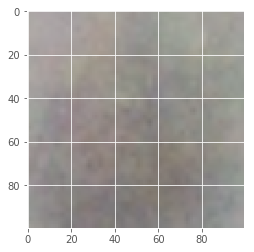

In [35]:
mean_img = ds.mean().astype(np.uint8)
plt.imshow(mean_img)
print(ds.mean().shape)

(100, 100, 3)


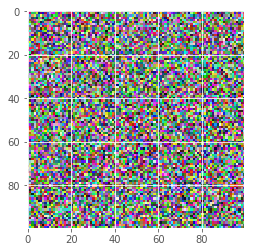

In [36]:
std_img = ds.std() #.astype(np.uint8)
plt.imshow(std_img)
print(std_img.shape)

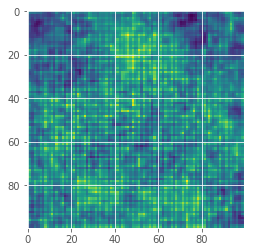

In [37]:
std_img = np.mean(std_img, axis=2)
plt.imshow(std_img)

(100, 100, 3)
(100, 100, 100, 3)


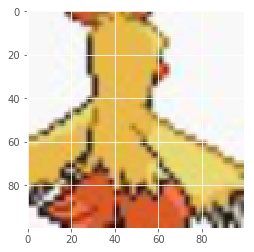

In [38]:
plt.imshow(ds.X[0])
print(ds.X[0].shape)
print(ds.X.shape)

In [39]:
for (X, y) in ds.train.next_batch(batch_size=10):
    print(X.shape)

(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)
(10, 100, 100, 3)


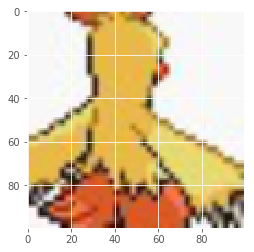

In [40]:
# Write a function to preprocess/normalize an image, given its dataset object
# (which stores the mean and standard deviation!)
def preprocess(img, ds):
    norm_img = (img - ds.mean()) / ds.std()
    return norm_img

# Write a function to undo the normalization of an image, given its dataset object
# (which stores the mean and standard deviation!)
def deprocess(norm_img, ds):
    img = norm_img * ds.std() + ds.mean()
    return img

# Just to make sure that you've coded the previous two functions correctly:
assert(np.allclose(deprocess(preprocess(ds.X[0], ds), ds), ds.X[0]))
plt.imshow(deprocess(preprocess(ds.X[0], ds), ds).astype(np.uint8))

In [41]:
# Calculate the number of features in your image.
# This is the total number of pixels, or (height x width x channels).
height = ds.X[0].shape[0]
width = ds.X[0].shape[1]
channels = ds.X[0].shape[2]

n_features = height * width * channels
print(n_features)

30000


In [78]:
# encoder_dimensions = [1024, 256, 64, 2]

# encoder_dimensions = [1024, 64, 16, 2]
encoder_dimensions = [1024, 64, 4]
# encoder_dimensions = [1024, 512, 256, 128, 64, 32, 16, 8]

In [79]:
tf.reset_default_graph()

In [80]:
X = tf.placeholder(tf.float32, shape = (None, n_features), name = "X")
                   
assert(X.get_shape().as_list() == [None, n_features])

In [81]:
def encode(X, dimensions, activation=tf.nn.tanh):
    # We're going to keep every matrix we create so let's create a list to hold them all
    Ws = []

    # We'll create a for loop to create each layer:
    for layer_i, n_output in enumerate(dimensions):

        # This will simply prefix all the variables made in this scope
        # with the name we give it.  Make sure it is a unique name
        # for each layer, e.g., 'encoder/layer1', 'encoder/layer2', or
        # 'encoder/1', 'encoder/2',... 
        with tf.variable_scope("encode/layer" + str(layer_i + 1)):

            # Create a weight matrix which will increasingly reduce
            # down the amount of information in the input by performing
            # a matrix multiplication.  You can use the utils.linear function.
            h, W = utils.linear(X, dimensions[layer_i])

            # Finally we'll store the weight matrix.
            # We need to keep track of all
            # the weight matrices we've used in our encoder
            # so that we can build the decoder using the
            # same weight matrices.
            Ws.append(W)
            
            # Replace X with the current layer's output, so we can
            # use it in the next layer.
            X = h
    
    z = X
    return Ws, z

In [82]:
# Then call the function
Ws, z = encode(X, encoder_dimensions)

# And just some checks to make sure you've done it right.
# assert(z.get_shape().as_list() == [None, 2])
# assert(len(Ws) == len(encoder_dimensions))

In [83]:
# We'll first reverse the order of our weight matrices
decoder_Ws = Ws[::-1]

# then reverse the order of our dimensions
# appending the last layers number of inputs.
decoder_dimensions = encoder_dimensions[::-1][1:] + [n_features]
print(decoder_dimensions)

assert(decoder_dimensions[-1] == n_features)

[64, 1024, 30000]


In [84]:
def decode(z, dimensions, Ws, activation=tf.nn.tanh):
    current_input = z
    for layer_i, n_output in enumerate(dimensions):
        # we'll use a variable scope again to help encapsulate our variables
        # This will simply prefix all the variables made in this scope
        # with the name we give it.
        with tf.variable_scope("decoder/layer/{}".format(layer_i)):

            # Now we'll grab the weight matrix we created before and transpose it
            # So a 3072 x 784 matrix would become 784 x 3072
            # or a 256 x 64 matrix, would become 64 x 256
            W = tf.transpose(Ws[layer_i])

            # Now we'll multiply our input by our transposed W matrix
            h = tf.matmul(current_input, W)

            # And then use a relu activation function on its output
            current_input = activation(h)

            # We'll also replace n_input with the current n_output, so that on the
            # next iteration, our new number inputs will be correct.
            n_input = n_output
    Y = current_input
    return Y

In [85]:
Y = decode(z, decoder_dimensions, decoder_Ws)

In [86]:
Y.get_shape().as_list()

[None, 30000]

In [87]:
# Calculate some measure of loss, e.g. the pixel to pixel absolute difference or squared difference
loss = tf.squared_difference(X, Y)

# Now sum over every pixel and then calculate the mean over the batch dimension (just like session 2!)
# hint, use tf.reduce_mean and tf.reduce_sum
cost = tf.reduce_sum(loss)

In [88]:
learning_rate = 0.001
optimizer = tf.train.AdamOptimizer(learning_rate).minimize(cost)

In [89]:
from libs import tboard
tboard.show_graph(tf.get_default_graph().as_graph_def())

Instructions for updating:
Use `tf.global_variables_initializer` instead.
0 300.418525


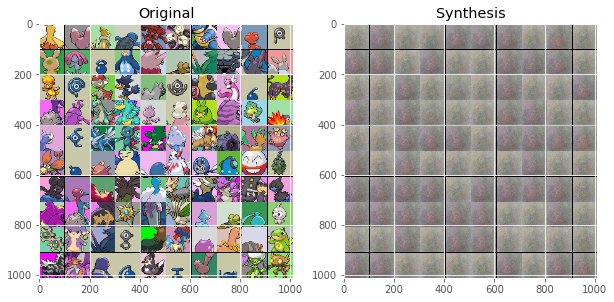

1 270.66795
2 246.704375
3 236.6515
4 229.609875
5 219.52295
6 211.354175
7 209.691975
8 210.5379
9 207.791475
10 202.9108625


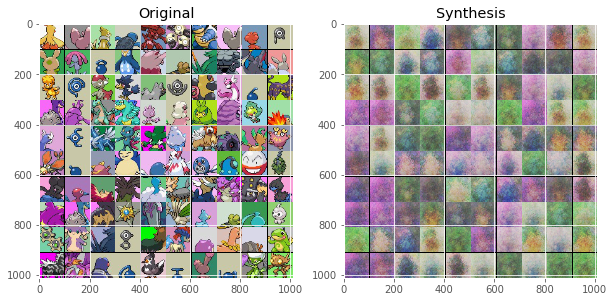

11 199.8566625
12 199.2007
13 199.9306375
14 200.0041875
15 198.121825
16 196.714675
17 195.88755
18 195.993125
19 196.060175
20 195.2812625


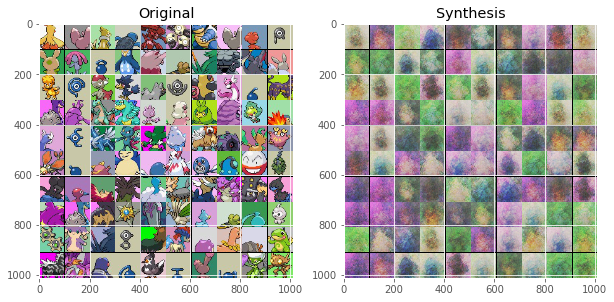

21 194.050325
22 194.8262125
23 196.170125
24 196.2904625
25 195.6111375
26 193.9135875
27 191.6828
28 189.7793125
29 189.3765625
30 189.4356875


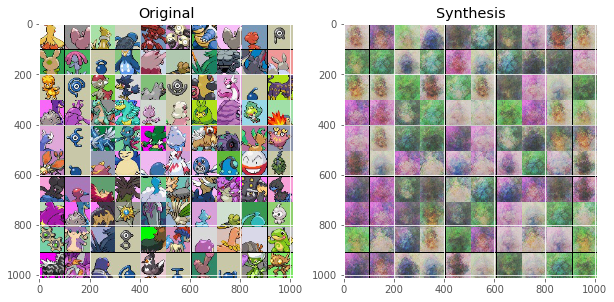

31 189.223275
32 188.3949625
33 187.272125
34 185.939625
35 184.2636625
36 183.0177125
37 182.4446125
38 181.61175
39 181.100475
40 180.4374


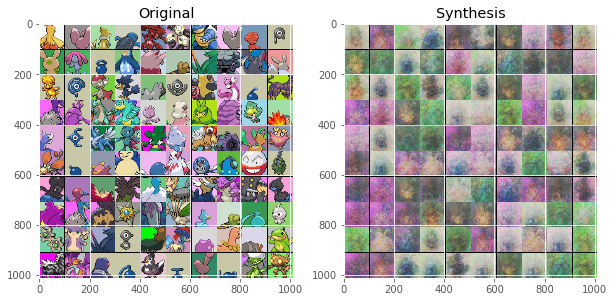

41 180.020975
42 179.4899125
43 179.1142
44 178.10605
45 176.6584625
46 175.48345
47 175.0909375
48 176.3665
49 178.0368375
50 180.124725


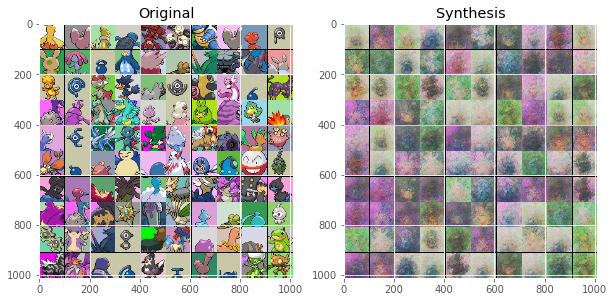

51 178.578275
52 176.9511875
53 177.2439125
54 179.0462875
55 177.5049125
56 175.857325
57 175.8828375
58 174.2070625
59 173.9235875
60 173.544775


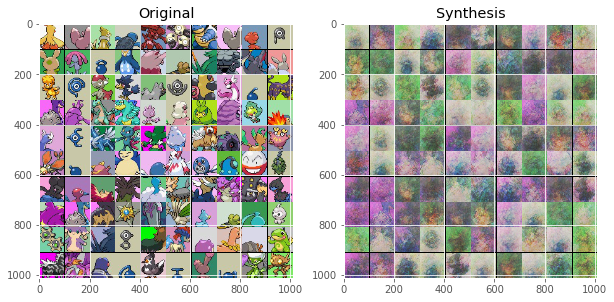

61 173.5379375
62 172.9825
63 172.0130625
64 172.605075
65 173.4375
66 175.55705
67 176.5801625
68 175.51815
69 174.8070125
70 174.8136625


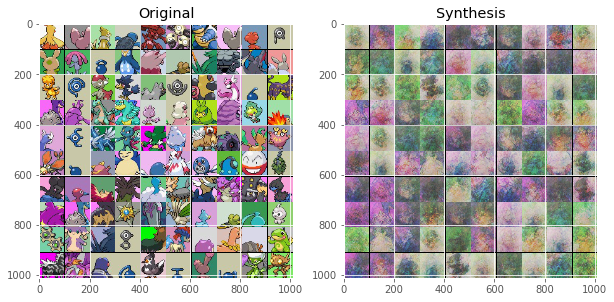

71 174.515075
72 171.58205
73 170.0229625
74 170.1778875
75 170.295625
76 171.0214875
77 169.6306
78 170.3931125
79 173.456025
80 173.6369125


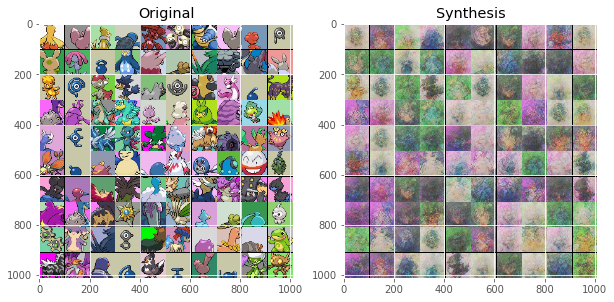

81 171.264275
82 168.4868125
83 168.331325
84 170.891775
85 172.7033875
86 174.0495625
87 174.9477
88 174.3814
89 173.8135
90 172.3306125


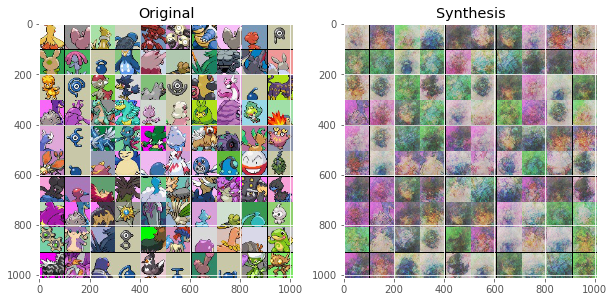

91 171.04595
92 170.392825
93 169.0577875
94 167.7839125
95 167.440025
96 165.765475
97 165.6145375
98 165.9866875
99 168.9228625
100 171.774075


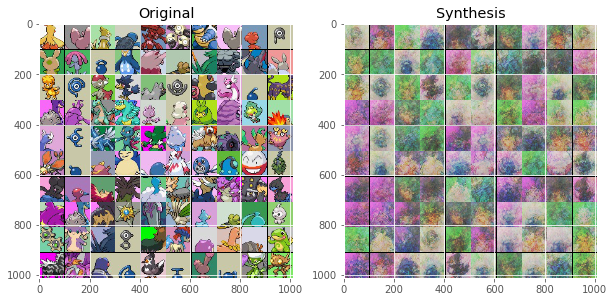

101 172.392425
102 171.4348625
103 171.2194125
104 170.2887875
105 167.948525
106 167.0899875
107 166.76485
108 165.847325
109 167.5592375
110 167.8817375


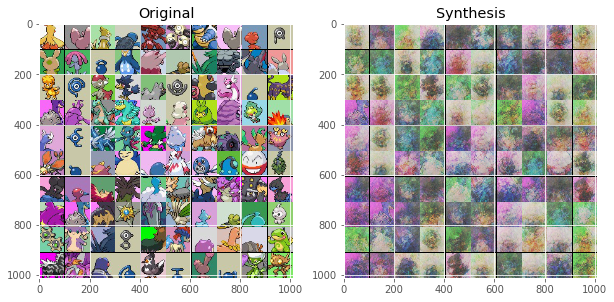

111 167.610825
112 167.9916375
113 169.2830125
114 171.252375
115 173.4599125
116 171.5900125
117 171.5111375
118 172.5855625
119 173.2644
120 175.27725


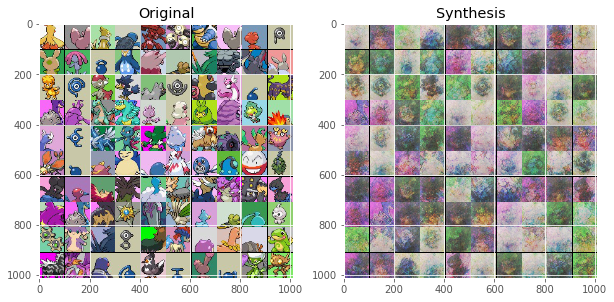

121 177.1975125
122 174.7586
123 173.8899375
124 174.1651625
125 173.968725
126 176.09815
127 176.6284625
128 173.93695
129 170.4687125
130 169.0781375


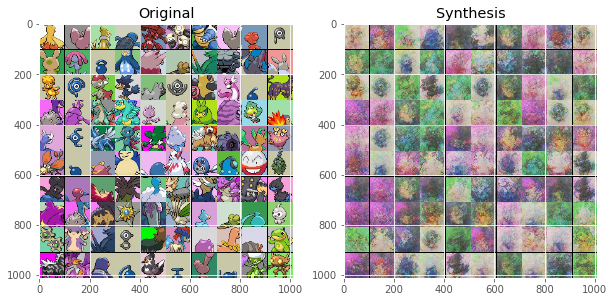

131 167.368075
132 167.383625
133 167.0226125
134 168.6161875
135 167.5772875
136 167.2702875
137 165.6117125
138 164.5170125
139 164.2067
140 164.0007875


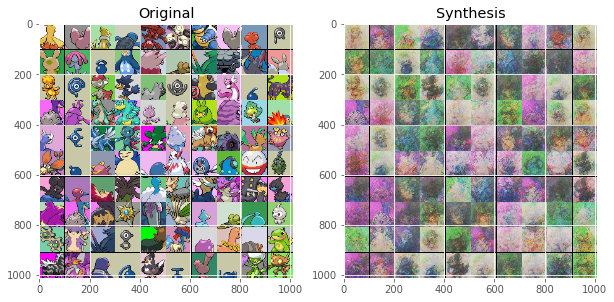

141 163.6657875
142 162.967575
143 164.0361
144 165.170875
145 166.2540125
146 167.40135
147 166.4251375
148 165.321475
149 162.953025
150 158.9133125


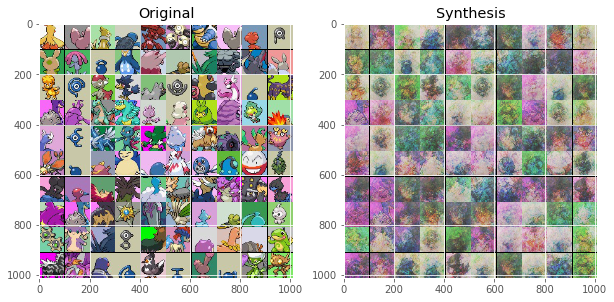

In [91]:
# Create a tensorflow session and initialize all of our weights:
sess = tf.Session()
sess.run(tf.initialize_all_variables())

# Some parameters for training
batch_size = 100
n_epochs = 151
step = 10

# We'll try to reconstruct the same first 100 images and show how
# The network does over the course of training.
examples = ds.X[:100]

# We have to preprocess the images before feeding them to the network.
# I'll do this once here, so we don't have to do it every iteration.
test_examples = preprocess(examples, ds).reshape(-1, n_features)

# If we want to just visualize them, we can create a montage.
test_images = utils.montage(examples).astype(np.uint8)

# Store images so we can make a gif
gifs = []

# Now for our training:
for epoch_i in range(n_epochs):
    
    # Keep track of the cost
    this_cost = 0
    
    # Iterate over the entire dataset in batches
    for batch_X, _ in ds.train.next_batch(batch_size = batch_size):
        
        # Preprocess and reshape our current batch, batch_X:
        this_batch = preprocess(batch_X, ds).reshape(-1, n_features)
        
        # Compute the cost, and run the optimizer.
        this_cost += sess.run([cost, optimizer], feed_dict = {X: this_batch})[0]
    
    # Average cost of this epoch
    avg_cost = this_cost / ds.X.shape[0] / batch_size
    print(epoch_i, avg_cost)
    
    # Let's also try to see how the network currently reconstructs the input.
    # We'll draw the reconstruction every `step` iterations.
    if epoch_i % step == 0:
        
        # Ask for the output of the network, Y, and give it our test examples
        recon = sess.run(Y, feed_dict = {X: test_examples})
                         
        # Resize the 2d to the 4d representation:
        rsz = recon.reshape(examples.shape)

        # We have to unprocess the image now, removing the normalization
        unnorm_img = deprocess(rsz, ds)
                         
        # Clip to avoid saturation
        clipped = np.clip(unnorm_img, 0, 255)

        # And we can create a montage of the reconstruction
        recon = utils.montage(clipped).astype(np.uint8)
        
        # Store for gif
        gifs.append(recon)

        fig, axs = plt.subplots(1, 2, figsize=(10, 10))
        axs[0].imshow(test_images)
        axs[0].set_title('Original')
        axs[1].imshow(recon)
        axs[1].set_title('Synthesis')
        fig.canvas.draw()
        plt.show()

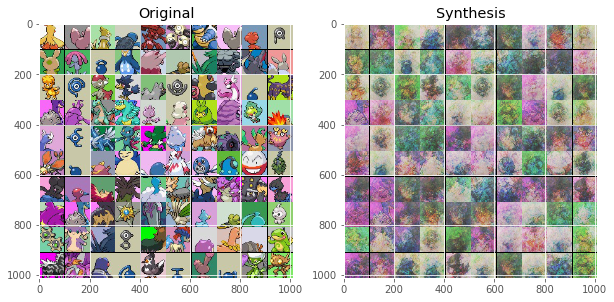

In [92]:
fig, axs = plt.subplots(1, 2, figsize=(10, 10))
axs[0].imshow(test_images)
axs[0].set_title('Original')
axs[1].imshow(recon)
axs[1].set_title('Synthesis')
fig.canvas.draw()
plt.show()
plt.imsave(arr=test_images, fname='./output/pokemon-test-4.png')
plt.imsave(arr=recon, fname='./output/pokemon-recon-4.png')

In [ ]:
zs = sess.run(z, feed_dict={X:test_examples})

In [51]:
zs.shape

(100, 2)

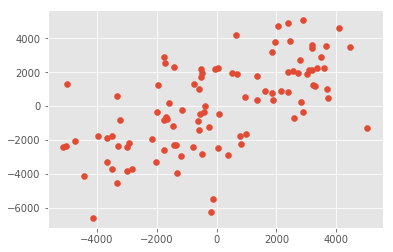

In [52]:
plt.scatter(zs[:, 0], zs[:, 1])

In [53]:
n_images = 100
idxs = np.linspace(np.min(zs) * 2.0, np.max(zs) * 2.0,
                   int(np.ceil(np.sqrt(n_images))))
xs, ys = np.meshgrid(idxs, idxs)
grid = np.dstack((ys, xs)).reshape(-1, 2)[:n_images,:]

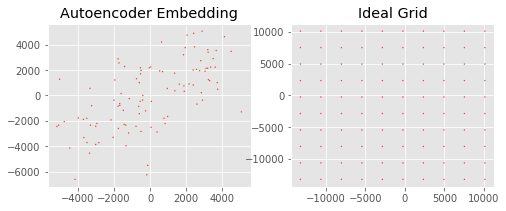

In [54]:
fig, axs = plt.subplots(1,2,figsize=(8,3))
axs[0].scatter(zs[:, 0], zs[:, 1],
               edgecolors='none', marker='o', s=2)
axs[0].set_title('Autoencoder Embedding')
axs[1].scatter(grid[:,0], grid[:,1],
               edgecolors='none', marker='o', s=2)
axs[1].set_title('Ideal Grid')

In [55]:
from scipy.spatial.distance import cdist
cost = cdist(grid[:, :], zs[:, :], 'sqeuclidean')
from scipy.optimize._hungarian import linear_sum_assignment
indexes = linear_sum_assignment(cost)

In [56]:
indexes

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
        85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]),
 array([63,  4, 95, 74, 21, 97, 93, 22, 26, 19, 14, 15, 75, 92,  9, 29, 25,
        30, 70, 41, 43, 11, 42, 23,  6, 60, 89, 16, 36, 79, 82, 98, 10, 50,
        88, 37, 55, 71, 86, 90, 73, 27,  2, 94,  0, 45,  5, 78, 96, 72,  3,
        87, 69, 28, 32, 54, 44, 64, 58, 51, 12, 66, 33, 35, 67, 59, 85, 40,
        84, 99,  8, 77, 46, 34, 24, 65, 56, 57, 91,  7, 18, 38, 83, 13, 48,
        61, 68, 20,  1, 52, 81, 76, 31, 47, 62, 53, 17, 49, 39, 80]))

In [59]:
min(indexes[1])

0

(3538.3054, 3651.3428)

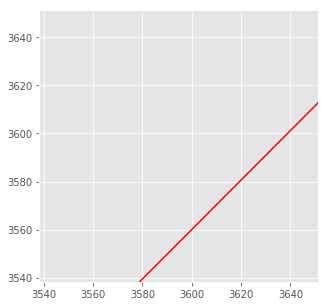

In [62]:
xmin = min(zs[1])
xmax = max(zs[1])
plt.figure(figsize=(5, 5))
for i in range(len(zs)):
    plt.plot([zs[indexes[1][i], 0], grid[i, 0]],
             [zs[indexes[1][i], 1], grid[i, 1]], 'r')
# plt.xlim([-3, 3])
# plt.ylim([-3, 3])

plt.xlim([xmin, xmax])
plt.ylim([xmin, xmax])

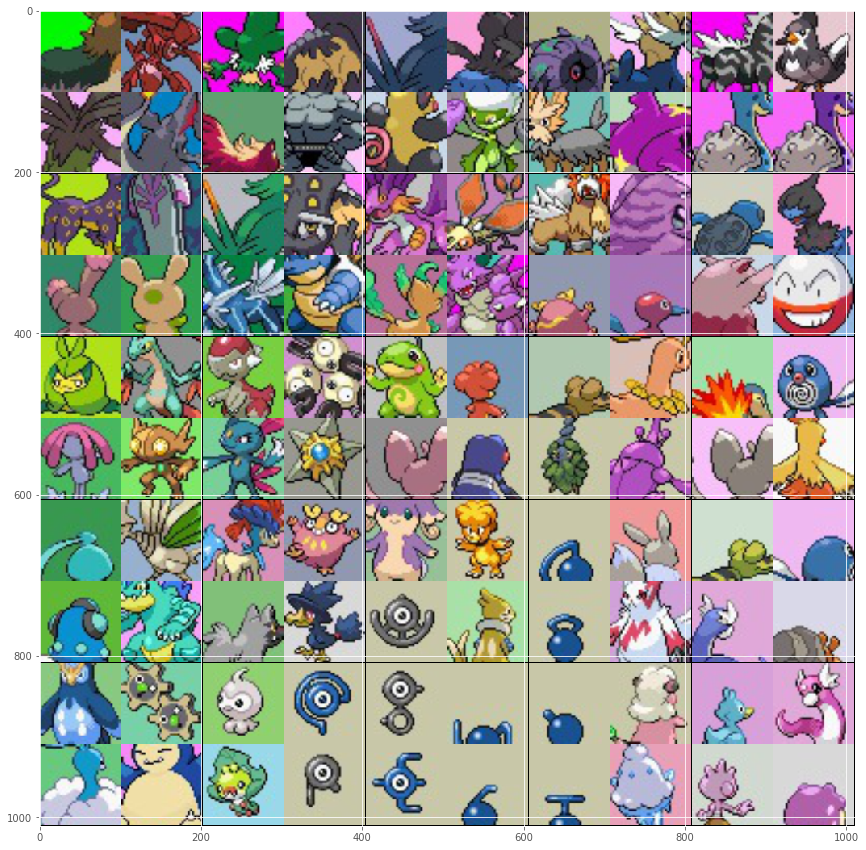

In [63]:
examples_sorted = []
for i in indexes[1]:
    examples_sorted.append(examples[i])
plt.figure(figsize=(15, 15))
img = utils.montage(np.array(examples_sorted)).astype(np.uint8)
plt.imshow(img,
           interpolation='nearest')
plt.imsave(arr=img, fname='sorted.png')

In [69]:
# This is a quick way to do what we could have done as
# a nested for loop:
zs = np.meshgrid(np.linspace(-6000, 6000, 10),
                 np.linspace(-6000, 6000, 10))

# Now we have 100 x 2 values of every possible position
# in a 2D grid from -1 to 1:
zs = np.c_[zs[0].ravel(), zs[1].ravel()]


In [70]:
recon = sess.run(Y, feed_dict={z : zs})

# reshape the result to an image:
rsz = recon.reshape(examples.shape)

# Deprocess the result, unnormalizing it
unnorm_img = deprocess(rsz, ds)

# clip to avoid saturation
clipped = np.clip(unnorm_img, 0, 255)

# Create a montage
img_i = utils.montage(clipped).astype(np.uint8)

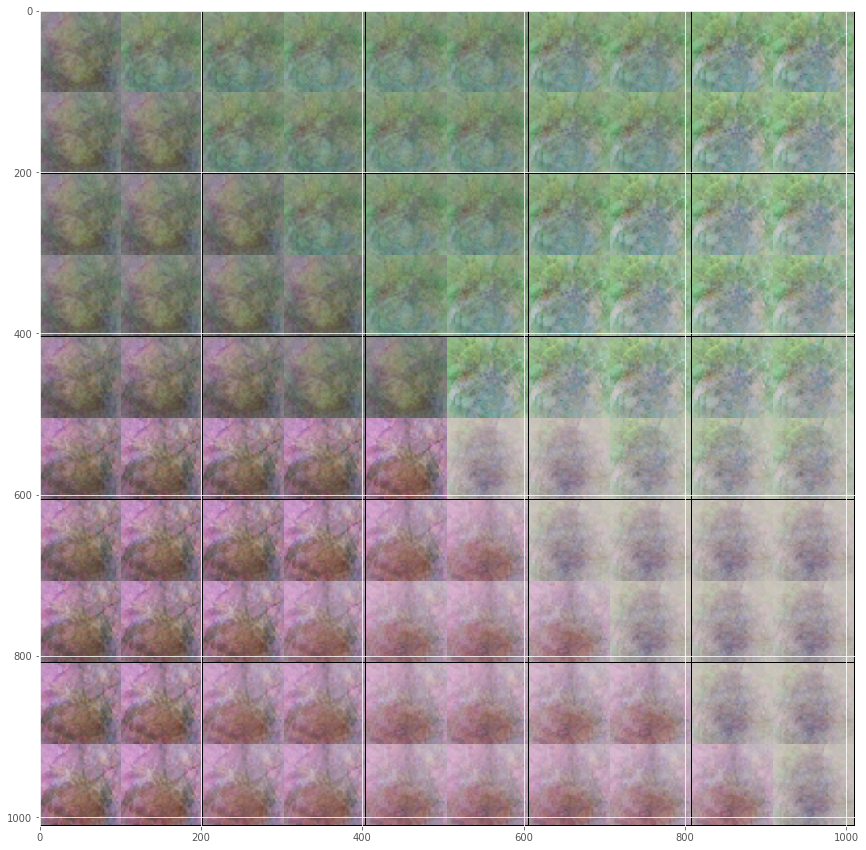

In [71]:
plt.figure(figsize=(15, 15))
plt.imshow(img_i)
plt.imsave(arr=img_i, fname='manifold.png')